# Experiments 🔬🧪🔍

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

More info about given dataset:<a href="https://arxiv.org/pdf/1901.11397v1.pdf" target="blank"><img align="center" src="https://info.arxiv.org/brand/images/brand-logo-primary.jpg" height="60" width="85" /></a>

In [ ]:
# изменить на свой путь ради удобсва

import tarfile

archive_path = "data/dataset.tar.gz"

output_path = "data"

with tarfile.open(archive_path, "r:gz") as tar:
    tar.extractall(path=output_path)

print("The archive has been successfully unpacked.")


The archive has been successfully unpacked.


In [ ]:
# изменить на свой путь куда были разархивированны данные

chain_info_path = "data/dataset/chain_info.csv"
hotel_info_path = "data/dataset/hotel_info.csv"
train_set_path = "data/dataset/train_set.csv"
test_set_path = "data/dataset/test_set.csv"

chain_info = pd.read_csv(chain_info_path)
hotel_info = pd.read_csv(hotel_info_path)
train_set = pd.read_csv(train_set_path, names=['image_id', 'hotel_id', 'image_url', 'image_source', 'upload_timestamp'], header=None)
test_set = pd.read_csv(test_set_path)


## EDA 🔍📊

In [ ]:
chain_info

,chain_id,chain_name
0,-1,unknown
1,0,Best Western
2,1,Hyatt
3,2,Marriott
4,3,Hilton
...,...,...
88,88,Comfort Inn
89,89,Fairfield Inn
90,90,Courtyard by Marriott
91,91,Hampton


In [ ]:
hotel_info

,hotel_id,hotel_name,chain_id,latitude,longitude
0,391,Extended Stay America - Fairbanks - Old Airpor...,72,64.83538,-147.82330
1,392,Hilton Hangzhou Qiandao Lake Resort,3,29.60819,119.07290
2,393,Taj Lands End,-1,19.04391,72.81879
3,395,Cambridge Suites Hotel Sydney,-1,46.13663,-60.19551
4,396,Tamanu Beach,14,-18.84213,-159.78794
...,...,...,...,...,...
49995,24274,Hotel Primus Valencia,-1,39.45768,-0.34541
49996,479422,Villa Nautilus,-1,20.20078,-87.45798
49997,354725,Arena Resort,-1,12.67615,101.30842
49998,292795,Indigo Hotel Restaurant & Bar,-1,6.43197,3.43206


In [ ]:
train_set

,image_id,hotel_id,image_url,image_source,upload_timestamp
0,3485,18187,https://traffickcam.com/images/2016/10/2015090...,traffickcam,9/9/15 17:23
1,3486,18187,https://traffickcam.com/images/2016/10/2015090...,traffickcam,9/9/15 17:23
2,3663,73224,https://traffickcam.com/images/2016/10/2015091...,traffickcam,9/17/15 19:33
3,2586939,86350,https://traffickcam.com/images/2017/2/20160125...,traffickcam,1/25/16 19:12
4,2586950,1533,https://traffickcam.com/images/2017/2/20160125...,traffickcam,1/25/16 17:23
...,...,...,...,...,...
1124210,9484584,478252,https://i.travelapi.com/hotels/13000000/129900...,travel_website,2019-12-24 21:10:28
1124211,9484585,478252,https://i.travelapi.com/hotels/13000000/129900...,travel_website,2019-12-24 21:10:28
1124212,9484586,478252,https://i.travelapi.com/hotels/13000000/129900...,travel_website,2019-12-24 21:10:28
1124213,9484587,478252,https://i.travelapi.com/hotels/13000000/129900...,travel_website,2019-12-24 21:10:28


In [ ]:
test_set

,image_id,hotel_id,image_url,image_source,upload_timestamp
0,2587571,79733,https://traffickcam.com/images/2017/4/20160304...,traffickcam,3/4/16 23:35
1,2587572,79733,https://traffickcam.com/images/2017/4/20160304...,traffickcam,3/4/16 23:35
2,2587573,79733,https://traffickcam.com/images/2017/4/20160304...,traffickcam,3/4/16 23:35
3,2587574,79733,https://traffickcam.com/images/2017/4/20160304...,traffickcam,3/4/16 23:35
4,2587796,88725,https://traffickcam.com/images/2017/6/20160531...,traffickcam,5/31/16 19:23
...,...,...,...,...,...
16166,3961457,93939,https://traffickcam.com/images/2019/9/20180827...,traffickcam,8/27/18 7:42
16167,3961641,34178,https://traffickcam.com/images/2019/9/20180828...,traffickcam,8/28/18 3:25
16168,3961642,34178,https://traffickcam.com/images/2019/9/20180828...,traffickcam,8/28/18 3:25
16169,3961643,34178,https://traffickcam.com/images/2019/9/20180828...,traffickcam,8/28/18 3:25


In [ ]:
# ref: https://stackoverflow.com/a/61592943/19566274

!pip install ipyplot

In [ ]:
import ipyplot


img_ex = train_set.sample(48)
image_urls = img_ex.image_url.tolist()
image_ids = img_ex.image_id.tolist()
# image_urls = train_set.image_url[:24].tolist()

ipyplot.plot_images(image_urls, labels=image_ids, max_images=len(image_urls), img_width=200)


Выше представлены несколько изображений фоторафий отелей из тренировочного датасета. На самих изображениях изображены различные комнаты квартир/отелей с различным окружающим интерьером. Важно отметить, что некоторые из фотографий перевернуты (например: [эта](https://traffickcam.com/images/2017/2/20160126_003646_R6Q5EX.jpg), [эта](https://traffickcam.com/images/2017/2/20160126_003646_6QK6W3.jpg) и [эта](https://traffickcam.com/images/2017/2/20160126_003646_30FFBF.jpg)) Update: но это никак не влияет на результат, так как используемая ниже модель может это отличить.

Также в процессе работы были найдены и фотографии не относящиеся к теме, например, [эта](https://i.travelapi.com/hotels/1000000/910000/903700/903617/7d99f5db_b.jpg) или [эта](https://i.travelapi.com/hotels/2000000/1750000/1744200/1744111/19f0153f_b.jpg)

Дальше будем работать с тренировочным датасетом

In [ ]:
train_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1124215 entries, 0 to 1124214
Data columns (total 5 columns):
 #   Column            Non-Null Count    Dtype 
---  ------            --------------    ----- 
 0   image_id          1124215 non-null  int64 
 1   hotel_id          1124215 non-null  int64 
 2   image_url         1124215 non-null  object
 3   image_source      1124215 non-null  object
 4   upload_timestamp  1124215 non-null  object
dtypes: int64(2), object(3)
memory usage: 42.9+ MB


Значит объектов в датасете $1124215$. Причем, каких-либо пропусков в столбцах нет.

Поверим на слово составителям датасета) и будем считать, что каждой фотографии соответсвует свой уникальный id'шник.

In [ ]:
f'Количество уникальных изображений: {(c := train_set.image_id.nunique())}'

'Количество уникальных изображений: 1055785'

In [ ]:
f'Количество совпадений: {train_set.shape[0] - c}'

'Количество совпадений: 68430'

Если предположить, что внутри одного отеля интерьер (а значит и большинство самих фотографий) не сильно отличается, то можно посмотреть на сбалансированность количества фотографий по отелям.  

In [ ]:
f'Количество уникальных отелей: {train_set.hotel_id.nunique()}'

# навание не врёт их действительно 50k

'Количество уникальных отелей: 50000'

In [ ]:
hp = train_set.hotel_id.value_counts()
hp

25050    474
10365    393
6798     328
34541    307
17211    280
        ... 
27805      4
21373      4
5638       4
21354      4
17025      4
Name: hotel_id, Length: 50000, dtype: int64

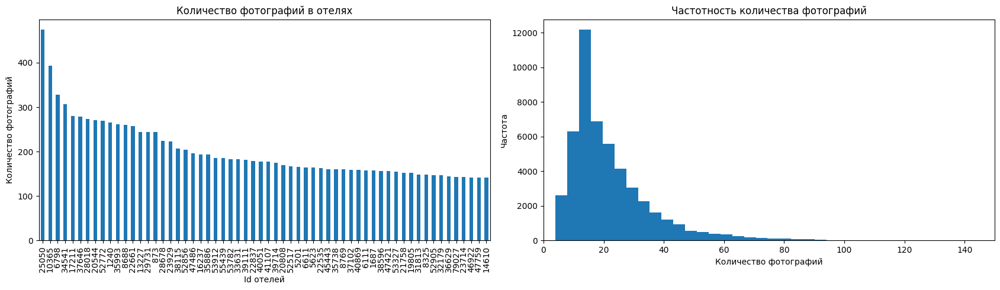

In [ ]:
fig, axs = plt.subplots(1, 2, figsize=(40, 5))

hp[:60].plot.bar(figsize=(17, 5), ax=axs[0])
axs[0].set_xlabel('Id отелей')
axs[0].set_ylabel('Количество фотографий')
axs[0].set_title('Количество фотографий в отелях')


hp.plot.hist(bins=120, ax=axs[1])
axs[1].set_xlim(0, 150)
axs[1].set_xlabel('Количество фотографий')
axs[1].set_ylabel('Частота')
axs[1].set_title('Частотность количества фотографий')

plt.tight_layout()
plt.show()

Первые несколько отелей имеют давольно много фото (см. рис. 1 (слева)), хотя среднее количество среди всех отелей не велико (см. рис. 2 (справа))

In [ ]:
hp.describe()

count    50000.000000
mean        22.484300
std         16.228388
min          4.000000
25%         13.000000
50%         18.000000
75%         27.000000
max        474.000000
Name: hotel_id, dtype: float64

Получается, что если смотреть по отелям, то датасет не сбалансирован, так как частотность распределена не равномерно. Аналогично получается и для ресурса с которого брались фотографии.

In [ ]:
train_set.image_source.value_counts()

travel_website    1079585
traffickcam         44630
Name: image_source, dtype: int64

---

Попробуем собрать некоторую статистку по размерам и формату фотографий

In [ ]:
from PIL import Image
import io
import requests
from tqdm.auto import tqdm
from random import sample

image_urls = train_set.image_url.tolist()

image_info_list = []
banned = 0

for image_url in tqdm(set(sample(image_urls, 1000))):
    response = requests.get(image_url, stream=True, verify=False)
    try:
        img = Image.open(response.raw)

        image_width, image_height = img.size
        image_format = img.format

        image_info = {
            "img_obj": img,
            "url": image_url,
            "width": image_width,
            "height": image_height,
            "format": image_format
        }
        image_info_list.append(image_info)
    except:
        banned += 1


  0%|          | 0/959 [00:00<?, ?it/s]

In [ ]:
f'Количество недоступных по ссылке изображений: {banned}'

'Количество недоступных по ссылке изображений: 183'

In [ ]:
# pd.DataFrame(image_info_list).to_csv("image_info_r1000.csv", index=False)

In [ ]:
# для повторного перезапуска будем использовать уже полученные ранее данные об изображениях

img_info = pd.read_csv("data/image_info_r1000.csv")
img_info.head()

,img_obj,url,width,height,format
0,<PIL.JpegImagePlugin.JpegImageFile image mode=...,https://i.travelapi.com/hotels/1000000/290000/...,350,233,JPEG
1,<PIL.JpegImagePlugin.JpegImageFile image mode=...,https://i.travelapi.com/hotels/2000000/1560000...,350,233,JPEG
2,<PIL.JpegImagePlugin.JpegImageFile image mode=...,https://i.travelapi.com/hotels/1000000/50000/4...,233,350,JPEG
3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,https://i.travelapi.com/hotels/1000000/10000/6...,350,245,JPEG
4,<PIL.JpegImagePlugin.JpegImageFile image mode=...,https://i.travelapi.com/hotels/6000000/5260000...,350,233,JPEG


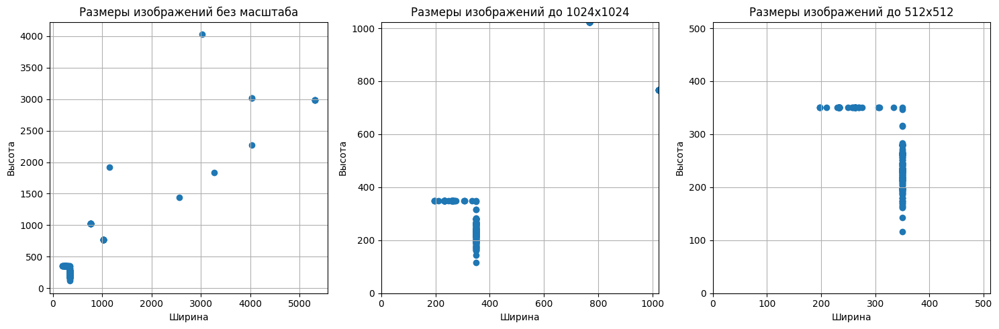

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

ax[0].scatter(img_info.width, img_info.height)
ax[0].grid()
ax[0].set_xlabel('Ширина')
ax[0].set_ylabel('Высота')
ax[0].set_title('Размеры изображений без масштаба')

ax[1].scatter(img_info.width, img_info.height)
ax[1].set_xlim(0, 1024)
ax[1].set_ylim(0, 1024)
ax[1].grid()
ax[1].set_xlabel('Ширина')
ax[1].set_ylabel('Высота')
ax[1].set_title('Размеры изображений до 1024x1024')

ax[2].scatter(img_info.width, img_info.height)
ax[2].set_xlim(0, 512)
ax[2].set_ylim(0, 512)
ax[2].grid()
ax[2].set_xlabel('Ширина')
ax[2].set_ylabel('Высота')
ax[2].set_title('Размеры изображений до 512x512')

plt.tight_layout()
plt.show()

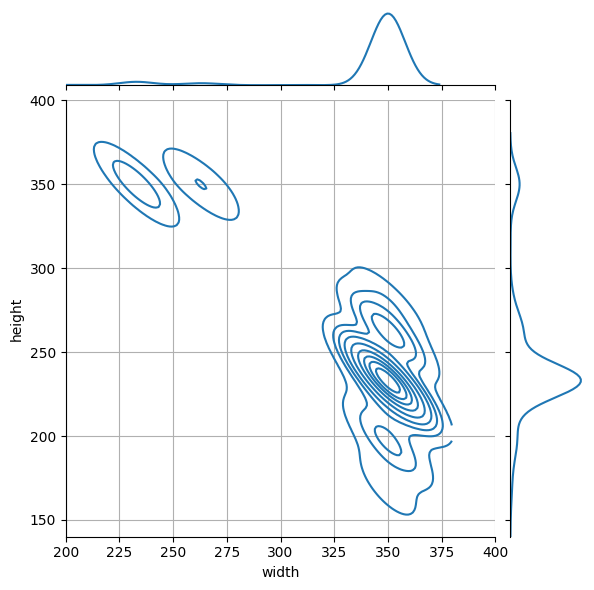

In [ ]:
sns.jointplot(x='width', y='height', data=img_info[(img_info.width < 1024) & (img_info.height < 1024)], kind='kde')
plt.xlim(200, 400)
plt.ylim(140, 400)
plt.grid()
plt.show()

Есть пару 'выбросов' в размерах фотографий, но в среднем фото имеют размер (414, 309) и формат PNG/JPEG.

In [ ]:
img_info.format.unique()

array(['JPEG', 'PNG'], dtype=object)

In [ ]:
img_info.describe()

,width,height
count,776.000000,776.000000
mean,414.253866,309.239691
std,463.590232,332.905042
min,197.000000,116.000000
25%,350.000000,233.000000
50%,350.000000,233.000000
75%,350.000000,263.000000
max,5312.000000,4032.000000


## Обогащение датасета описаниями

### Obtain captions 👉📃

Будем пользоваться официальной имплементацией автора CLIP-Interrogator v.2 (<a href="https://github.com/pharmapsychotic/clip-interrogator" target="blank"><img align="center" src="https://raw.githubusercontent.com/rahuldkjain/github-profile-readme-generator/888aff31e1d26dd2a6acf6afebbc34970aeb0118/src/images/icons/Social/github.svg" height="20" width="20" /></a> [@pharmapsychotic](https://github.com/pharmapsychotic/clip-interrogator)). Поясню почему именно эта имплементация, а не другуая. Во-первых, предложенная ссылка в самом задании на колаб (<a href="https://github.com/rupeshs/diffusionmagic/tree/main" target="blank"><img align="center" src="https://raw.githubusercontent.com/rahuldkjain/github-profile-readme-generator/888aff31e1d26dd2a6acf6afebbc34970aeb0118/src/images/icons/Social/github.svg" height="20" width="20" /></a> [diffusionmagic](https://github.com/rupeshs/diffusionmagic/tree/main)) не иммеет имплементации CLIP-Interrogator (по крайней мере мне таковой не удалось найти ни в веб интерфейсе при запуске, ни в самом репозитории). Почему я не использовал решение непосредственно из AUTOMATIC1111, так как в веб интерфейсе нет возможности получить промты сразу для батча картинок, тем более, что [могут возникнуть проблемы](https://github.com/camenduru/stable-diffusion-webui-colab#-important--according-to-the-official-statement-the-colab-free-of-charge-tier-is-not-available-for-the-stable-diffusion-webui--we-can-only-use-it-with-any-paid-plan-also-i-asked-the-colab-team-to-change-the-scary--message-httpsgithubcomgooglecolabcolabtoolsissues3591-and-official-statement-no-bans-planned-if-you-click-through-will-delete-the-vms-at-some-point) при запуске в бесплатной версии колаба.

Поэтому будем использовать имплементацию выше, тем более, что код можно изменить для получения описания для целого датасета картинок и все это сразу записывать в файл.

Следующий код взят из официального репозитория данного метода: [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/pharmapsychotic/clip-interrogator/blob/main/clip_interrogator.ipynb) и переписан под собственные нужды.

Useful link: <a href="https://github.com/moein-shariatnia/OpenAI-CLIP" target="blank"><img align="center" src="https://raw.githubusercontent.com/rahuldkjain/github-profile-readme-generator/888aff31e1d26dd2a6acf6afebbc34970aeb0118/src/images/icons/Social/github.svg" height="20" width="20" /></a> [@moein-shariatnia](https://github.com/moein-shariatnia/OpenAI-CLIP) (Simple implementation of OpenAI CLIP model in PyTorch.)

In [ ]:
#@title Check GPU ✅🖥️
!nvidia-smi -L

/bin/bash: line 1: nvidia-smi: command not found


In [ ]:
#@title Setup 🔧🔃⚙️
import os, subprocess

def setup():
    install_cmds = [
        # ['pip', 'install', 'gradio'],  # только для веба
        ['pip', 'install', 'open_clip_torch'],
        ['pip', 'install', 'clip-interrogator'],
    ]
    for cmd in install_cmds:
        print(subprocess.run(cmd, stdout=subprocess.PIPE).stdout.decode('utf-8'))

setup()


caption_model_name = 'blip-base' #@param ["blip-base", "blip-large", "git-large-coco"]
clip_model_name = 'ViT-L-14/openai' #@param ["ViT-L-14/openai", "ViT-H-14/laion2b_s32b_b79k"]

from clip_interrogator import Config, Interrogator

config = Config()
config.quiet = True
config.clip_model_name = clip_model_name
config.caption_model_name = caption_model_name
ci = Interrogator(config)

def image_analysis(image):
    image = image.convert('RGB')
    image_features = ci.image_to_features(image)

    top_mediums = ci.mediums.rank(image_features, 5)
    top_artists = ci.artists.rank(image_features, 5)
    top_movements = ci.movements.rank(image_features, 5)
    top_trendings = ci.trendings.rank(image_features, 5)
    top_flavors = ci.flavors.rank(image_features, 5)

    medium_ranks = {medium: sim for medium, sim in zip(top_mediums, ci.similarities(image_features, top_mediums))}
    artist_ranks = {artist: sim for artist, sim in zip(top_artists, ci.similarities(image_features, top_artists))}
    movement_ranks = {movement: sim for movement, sim in zip(top_movements, ci.similarities(image_features, top_movements))}
    trending_ranks = {trending: sim for trending, sim in zip(top_trendings, ci.similarities(image_features, top_trendings))}
    flavor_ranks = {flavor: sim for flavor, sim in zip(top_flavors, ci.similarities(image_features, top_flavors))}

    return medium_ranks, artist_ranks, movement_ranks, trending_ranks, flavor_ranks

def image_to_prompt(image, mode):
    ci.config.chunk_size = 2048 if ci.config.clip_model_name == "ViT-L-14/openai" else 1024
    ci.config.flavor_intermediate_count = 2048 if ci.config.clip_model_name == "ViT-L-14/openai" else 1024
    image = image.convert('RGB')
    if mode == 'best':
        return ci.interrogate(image)
    elif mode == 'classic':
        return ci.interrogate_classic(image)
    elif mode == 'fast':
        return ci.interrogate_fast(image)
    elif mode == 'negative':
        return ci.interrogate_negative(image)


Так как CLIP-Interrogator (очевидно) работатет на основе CLIP, а тот в свою очередь [использует](https://github.com/AUTOMATIC1111/stable-diffusion-webui/wiki/Features#clip-interrogator) словарь лейблов (эмбеддиногов), то удалим не подходящие под наши картинки лейблы, а именно `artists.txt`. Это увелечит вероятности других (правильных / более подходящих лейблов) ([proof](https://www.kaggle.com/code/leonidkulyk/lb-0-45836-blip-clip-clip-interrogator?scriptVersionId=120016399&cellId=3)). А так как мы все-таки хотим использовать описание для рекламы, то удалим ещё и `negative.txt`.

Так как при генерации используются лейблы всех категорий, то просто заменим генирирующую функцию на свою, сократив количиство типов лейблов.

In [ ]:
from PIL import Image
from typing import List, Optional
from clip_interrogator.clip_interrogator import _merge_tables, _truncate_to_fit


def my_interrogate_fast(self, image: Image, max_flavors: int=32, caption: Optional[str]=None) -> str:
    """Fast mode simply adds the top ranked terms after a caption. It generally results in
    better similarity between generated prompt and image than classic mode, but the prompts
    are less readable."""
    caption = caption or self.generate_caption(image)
    image_features = self.image_to_features(image)
    merged = _merge_tables([self.flavors, self.mediums, self.movements], self)
    tops = merged.rank(image_features, max_flavors)
    return _truncate_to_fit(caption + ", " + ", ".join(tops), self.tokenize)

Interrogator.interrogate_fast = my_interrogate_fast

Изменим код, чтобы генерировать промты сразу для нескольких изображений, которые доступны по ссылке.

In [ ]:
# @markdown This will generate prompts for every image in a given list of its urls and save results
# @markdown to a desc.csv file in the same folder.
# @markdown Don't execute this cell, use already obtained captions

import csv
import os
from IPython.display import clear_output, display
from PIL import Image
import requests
# import tqdm
from tqdm import tqdm

folder_path = "/content/my_images"
prompt_mode = 'fast' #@param ["best","fast","classic","negative"]
output_mode = 'desc.csv'

def imgs2promts(test_set):
    al_wr = 0

    csv_path = os.path.join(folder_path, 'desc.csv')
    with open(csv_path, 'w', encoding='utf-8', newline='') as f:
        w = csv.writer(f, quoting=csv.QUOTE_MINIMAL)

        for idx, id_link in tqdm(test_set.iterrows()):
            img_id, link = id_link['image_id'], id_link['image_url']

            if not (link.endswith('.jpg') or link.endswith('.png')):
                continue

            prompt = None
            response = requests.get(link, stream=True, verify=False)
            if response.status_code != 404:
                image = Image.open(response.raw).convert('RGB')
                prompt = image_to_prompt(image, prompt_mode)
                print(prompt)

            if prompt is not None:
                w.writerow([img_id, link, prompt])
                al_wr += 1

            if al_wr == 1000:
                break



In [ ]:
# don't execute this cell, use already obtained captions

!mkdir /content/my_images # изменить на свой путь для удобсва

In [ ]:
# don't execute this cell, use already obtained captions

train_set1 = train_set.sample(100000)
imgs2promts(train_set1)

In [ ]:
def get_img_link(id: int) -> str:
    return train_set[train_set.image_id == id].image_url.values[0]

def show_img(id: int):
    img = Image.open(requests.get(get_img_link(id), stream=True, verify=False).raw)
    display(img)

## Analysis of obtained captions 🔍📝

In [ ]:
# для повторного запуска будем использовать полученные ранее данные

lids = pd.read_csv("data/desc_1000.csv") # изменить на свой путь при необходимости


In [ ]:
lids

,image_id,image_url,prompt
0,6419360,https://i.travelapi.com/hotels/1000000/120000/...,"a hotel room with a bed, desk, chair, and tele..."
1,8133768,https://i.travelapi.com/hotels/7000000/6010000...,"a bathroom with a sink and a mirror, interior ..."
2,6798095,https://i.travelapi.com/hotels/1000000/920000/...,"a bedroom with two beds and a television, othe..."
3,6434237,https://i.travelapi.com/hotels/1000000/530000/...,"a bedroom with a bed, television, and a chair,..."
4,6388504,https://i.travelapi.com/hotels/1000000/530000/...,"a hotel room with a bed, desk, and television,..."
...,...,...,...
995,8646736,https://i.travelapi.com/hotels/10000000/930000...,"a bed in a room, beds, white bed, small bedroo..."
996,7007564,https://i.travelapi.com/hotels/2000000/1730000...,"a bathroom with a glass shower and a toilet, p..."
997,6856886,https://i.travelapi.com/hotels/1000000/60000/5...,"a hotel room with two beds and a desk, bed on ..."
998,3890315,https://traffickcam.com/images/2018/10/2017091...,"a chair and a table in a room, cubical meeting..."


посмотрим насколько точны описания

In [ ]:
import requests
import textwrap
from PIL import Image
from typing import List

def plot_images_with_descriptions(images_urls: List[str], descriptions: List[str], width: int=65, cols: int=3, figsize=(38, 60), plot_type: int=1):
    """
    Displays images in rows with corresponding descriptions.
    Parameters:
    images_urls (list): List of URL links to images.
    descriptions (list): List of descriptions for each image.
    rows (int): Number of rows in the grid.
    cols (int): Number of columns in the grid.
    figsize (tuple): Figure size (width, height).
    plot_type (int): Type of plot.
    """
    num_images = len(images_urls)
    rows = -(-num_images // cols)
    fig, axes = plt.subplots(rows, cols, figsize=figsize)

    for i, ax in enumerate(axes.flatten()):
        if i < num_images:
            response = requests.get(images_urls[i], stream=True, verify=False)
            image = Image.open(response.raw).convert('RGB')
            image = image.resize((2048, 2048))


            ax.imshow(image)

            if plot_type == 1:
                wrapped_text = "\n".join(textwrap.wrap(descriptions[i], width=65))
                ax.set_title(wrapped_text, size=25)
                ax.axis("off")
            elif plot_type == 2:
                if i % 3 == 1:
                    wrapped_text = "\n".join(textwrap.wrap(descriptions[i // 3], width=width))
                    ax.set_title(wrapped_text, size=25)
                ax.axis("off")
        else:
            ax.axis("off")

    plt.tight_layout()
    plt.show()


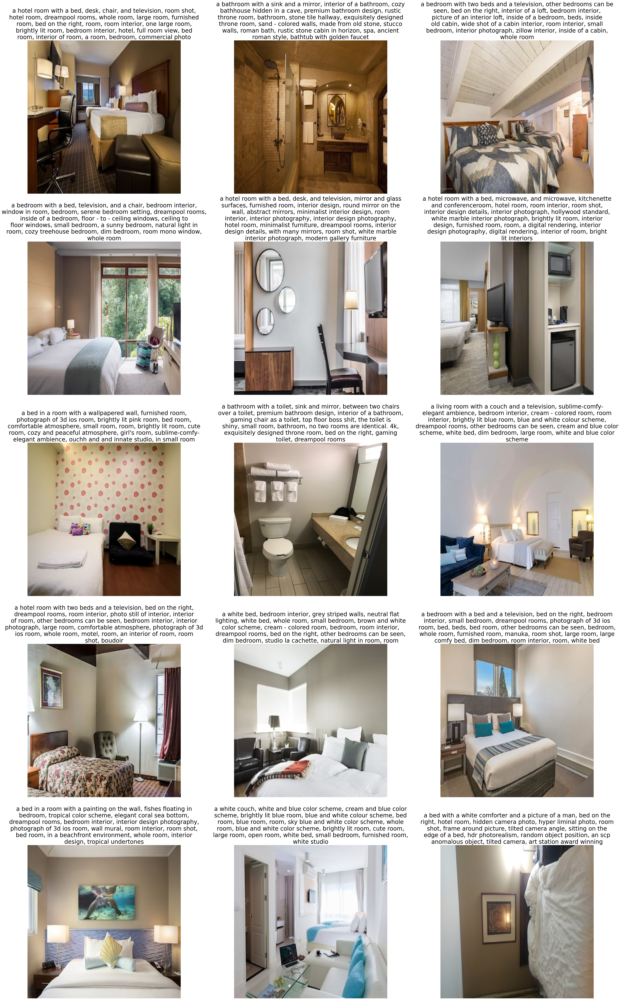

In [ ]:
# ids = [14, ]
# interesting_imgs = [llids.image_url.values[i] for i in ids]

plot_images_with_descriptions(lids.image_url.values[:15], lids.prompt.values[:15], cols=3, figsize=(38, 60))


Как видно, точность описаний для большинства фотографий довольно высока. Но например, для повернутых изображений она начинает страдать (см. последнее фото выше), но справедливости ради стоит отметить, что то, что изображение повёрнуто и расположение кровати были угаланы правильно. Также в некоторых описаниях появляются объекты, которых в реальности на изображениях нет. Но в общем стилистика по описанию совпадает с тем, что изображенно.  

Для кластеризации воспользуемся токенизатором и энкодером, встроенными в CLIP-Interrogator. Полученные эмбеддинги текста можно кластеризовать любым доступным алгоритмом кластеризации, а для отображения можно использовать, например, t-SNE.

In [ ]:
import torch
from  tqdm import tqdm

caption_embs = []
ci._prepare_clip()
for row in tqdm(lids.itertuples()):
    caption = row.prompt
    text_tokens = ci.tokenize([caption]).to(ci.device)
    with torch.no_grad(), torch.cuda.amp.autocast():
        text_features = ci.clip_model.encode_text(text_tokens)
        text_features /= text_features.norm(dim=-1, keepdim=True)
    caption_embs.append(text_features)

lids['embeddings'] = caption_embs


1000it [04:05,  4.08it/s]


In [ ]:
# bad idea bc of this https://discuss.pytorch.org/t/how-to-store-tensors-as-tensors-instead-of-strings/147157

# lids = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/CV/data/desc_1000_w_embds.csv")

In [ ]:
# @title Some lines of code to draw DBSCSN labels in 3D
import numpy as np
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
import plotly.express as px
import torch

embedding_array = np.array([tensor.squeeze().numpy() for tensor in np.array(lids.embeddings)])

tsne = TSNE(n_components=3, random_state=42)
tsne_results = tsne.fit_transform(embedding_array)

dbscan = DBSCAN(eps=3, min_samples=3)
db_labels = dbscan.fit_predict(tsne_results)

fig = px.scatter_3d(
    x=tsne_results[:, 0],
    y=tsne_results[:, 1],
    z=tsne_results[:, 2],
    color=db_labels,
    color_continuous_scale='Edge', # RdBu, viridis, Portland, Rainbow, Turbo, Edge
    labels={'color': 'Cluster'},
    title='t-SNE Visualization with DBSCAN Clustering'
)

fig.show()


In [ ]:
f'Получившееся число кластеров: {len(set(db_labels))}'

'Получившееся число кластеров: 41'

Впринципе взуально изображенные клаасы разделимы, то есть гиперпараметры подобраны нормально

In [ ]:
lids['label'] = db_labels

In [ ]:
lids = pd.read_csv("data/desc_1000_w_embds_w_labels.csv")

ниже разбиение K-Means'ом на 41 класс (просто ради интереса)

In [ ]:
# @title Some lines of code to draw K-Means labels in 3D
from sklearn.cluster import KMeans


embedding_array = np.array([tensor.squeeze().numpy() for tensor in np.array(lids.embeddings)])

tsne = TSNE(n_components=3, random_state=42)
tsne_results = tsne.fit_transform(embedding_array)

num_clusters = 41
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans_labels = kmeans.fit_predict(tsne_results)

fig = px.scatter_3d(
    x=tsne_results[:, 0],
    y=tsne_results[:, 1],
    z=tsne_results[:, 2],
    color=kmeans_labels,
    labels={'color': 'Cluster'},
    color_continuous_scale='Turbo',
    title='t-SNE Visualization with K-Means Clustering'
)

fig.show()


Посмотрим на лейблы и картинки внутри отдельных кластеров. Для простоты анализа будем использовать только *усреднённый* эмбеддинг каждого кластера и изобразим только несколько его картинок.

In [ ]:
def my_mean(x):
    return np.array(x.values.sum() / len(x))


specific_aggregations = {'embeddings': my_mean}
other_columns_aggregation = {col: list for col in lids.columns if col not in ['embeddings', 'label']}

aggregations = {**specific_aggregations, **other_columns_aggregation}

llids = lids.groupby('label').agg(aggregations)


In [ ]:
llids.head()

,embeddings,image_id,image_url,prompt
label,,,,
-1,"[[-0.043277398, 0.020164797, 0.016605938, -0.0...","[6388504, 7568679, 6416571, 6920985, 6796664, ...",[https://i.travelapi.com/hotels/1000000/530000...,"[a hotel room with a bed, desk, and television..."
0,"[[-0.052900482, 0.017724551, 0.02032604, -0.00...","[6419360, 6798095, 6434237, 6963606, 6324022, ...",[https://i.travelapi.com/hotels/1000000/120000...,"[a hotel room with a bed, desk, chair, and tel..."
1,"[[-0.04298608, 0.028726513, 0.02169221, -0.012...","[7618388, 6672051, 6860675, 8617110, 3841292, ...",[https://i.travelapi.com/hotels/4000000/382000...,"[a hotel room with a bed, microwave, and micro..."
2,"[[-0.056066535, 0.015391955, 0.027674058, 0.00...","[8133768, 3926657, 6229417, 6256492, 6231527, ...",[https://i.travelapi.com/hotels/7000000/601000...,"[a bathroom with a sink and a mirror, interior..."
3,"[[-0.057578217, 0.0135066, -0.0025229603, -0.0...","[8192278, 8240515, 6010808, 7526996, 6942177, ...",[https://i.travelapi.com/hotels/3000000/284000...,"[a living room with a couch and a television, ..."


Для получения *усреднённого* эмбеддинга усредним все эмбеддинги каждого кластера и (так как в CLIP-Interrogator нет декодера) для полученного вектора выведем промт, эмбеддинг которого является самым близким к среднему из всех для данного кластера.

Такая логика полностью сходится с принципом работы функции `rank_top` из оригинального [решения](https://github.com/pharmapsychotic/clip-interrogator/blob/2cf03aaf6e704197fd0dae7c7f96aa59cf1b11c9/clip_interrogator/clip_interrogator.py#L257C9-L257C9), только мы вместо сравнения картники и массива текстов, будем сравнивать средний вектор-эмбеддинг и массив полученных промптов для каждого из кластеров.

In [ ]:
nearest_captions = []

for label in tqdm(llids.index.values):
    avg_emb = llids.loc[label, 'embeddings']
    nearest_captions.append(ci.rank_top(avg_emb, llids.loc[label, 'prompt']))

100%|██████████| 41/41 [05:17<00:00,  7.73s/it]


In [ ]:
llids['nearest_captions'] = nearest_captions

In [ ]:
llids.head()

,embeddings,image_id,image_url,prompt,nearest_captions
label,,,,,
-1,"[[-0.043277398, 0.020164797, 0.016605938, -0.0...","[6388504, 7568679, 6416571, 6920985, 6796664, ...",[https://i.travelapi.com/hotels/1000000/530000...,"[a hotel room with a bed, desk, and television...","a hotel room with a large bed and a tv, luxuri..."
0,"[[-0.052900482, 0.017724551, 0.02032604, -0.00...","[6419360, 6798095, 6434237, 6963606, 6324022, ...",[https://i.travelapi.com/hotels/1000000/120000...,"[a hotel room with a bed, desk, chair, and tel...","a hotel room with two beds and a television, r..."
1,"[[-0.04298608, 0.028726513, 0.02169221, -0.012...","[7618388, 6672051, 6860675, 8617110, 3841292, ...",[https://i.travelapi.com/hotels/4000000/382000...,"[a hotel room with a bed, microwave, and micro...","a hotel room with a bed and a desk, bed on the..."
2,"[[-0.056066535, 0.015391955, 0.027674058, 0.00...","[8133768, 3926657, 6229417, 6256492, 6231527, ...",[https://i.travelapi.com/hotels/7000000/601000...,"[a bathroom with a sink and a mirror, interior...","a bathroom with a sink, toilet, and mirror, in..."
3,"[[-0.057578217, 0.0135066, -0.0025229603, -0.0...","[8192278, 8240515, 6010808, 7526996, 6942177, ...",[https://i.travelapi.com/hotels/3000000/284000...,"[a living room with a couch and a television, ...","a living room with a couch, chair, television ..."


In [ ]:
# для повторного запуска будем использовать полученные ранее данные

llids = pd.read_csv("data/llids_w_nearest_captions.csv")

In [ ]:
from random import sample
iurls = []
caps = []
for row in llids.itertuples():
    cap = row.nearest_captions
    caps.append(cap)

    iurl = sample(row.image_url, 3)
    iurls += iurl


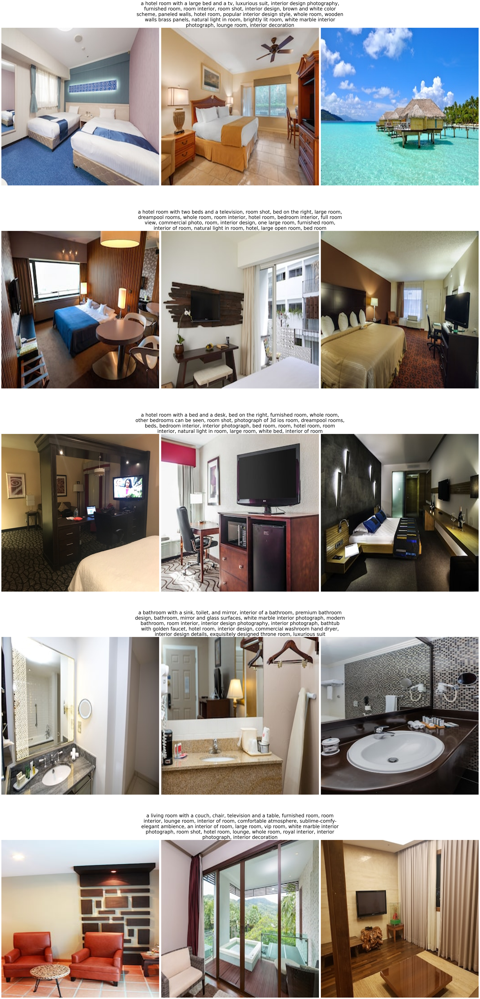

In [ ]:
n_row = 5

plot_images_with_descriptions(iurls[:3*n_row], caps[:n_row], width=85, cols=3, figsize=(35, 75), plot_type=2)

Получилось двовльно прилично, видно, что в одной группе фотографии имеют схожую стилистику, сопадающую с общим описанием. Также объекты представленные в описании совпадают с объектами, представленными в фотографиях, если смотреть на ячейку выше.

## Изменение изображения при помощи диффузионной модели 🖼️🔧🔃✅

Выберем наиболее интересные по стилю фотографии и отрисуем их ниже

In [ ]:
!pip install ipyplot

In [ ]:
import ipyplot


cool_ids = [6373143, 6166037, 8085527, 6518180, 6183644, 7502480, 6185679, 7831089, 6906891,
            7071937, 6267528, 7582632, 7294038, 6928768, 7683058, 6053860, 7758152, 6108644, 6621643,
            7816096, 9430349, 6541671, 6944985, 6046094, 6344486, 7831343, 8005795, 6231135]

cool_imgs = lids[lids.image_id.isin(cool_ids)]

image_urls = cool_imgs.image_url.tolist()
image_ids = cool_imgs.image_id.tolist()

ipyplot.plot_images(image_urls, labels=image_ids, max_images=len(image_urls), img_width=200)


In [ ]:
cool_imgs

,image_id,image_url,prompt
176,6906891,https://i.travelapi.com/hotels/2000000/1510000...,"a bathroom with a sink and a mirror, interior ..."
186,6185679,https://i.travelapi.com/hotels/1000000/40000/3...,"a room with a bed, a couch, a chair, a table a..."
187,6108644,https://i.travelapi.com/hotels/1000000/20000/1...,a bed with a red comforter and a black wallpap...
195,9430349,https://i.travelapi.com/hotels/13000000/126000...,"a living room with a fireplace and a couch, wa..."
287,7831089,https://i.travelapi.com/hotels/5000000/4570000...,"a hotel room with a bed, desk and television, ..."
288,6166037,https://i.travelapi.com/hotels/1000000/30000/2...,"a bed with a tray of food on it, brightly lit ..."
316,8005795,https://i.travelapi.com/hotels/6000000/5270000...,"a loft with a loft bed and a ladder, home inte..."
439,8085527,https://i.travelapi.com/hotels/6000000/5640000...,"a bed in a room, room shot, brightly lit room,..."
463,6944985,https://i.travelapi.com/hotels/2000000/1300000...,"a bedroom with two beds and a desk, room inter..."
479,6928768,https://i.travelapi.com/hotels/1000000/920000/...,"a living room with a fireplace and couches, th..."


Сохраним эти картинки и дальше будем использовать данный ноутбук для запуска SDXL в колабе: [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/TheLastBen/fast-stable-diffusion/blob/main/fast_stable_diffusion_AUTOMATIC1111.ipynb)

In [ ]:
import os
from PIL import Image

save_dir = 'images'

os.makedirs(save_dir, exist_ok=True)

for i, row in enumerate(cool_imgs.iterrows()):
    image_id, image_url= row[1].image_id, row[1].image_url

    response = requests.get(image_url, stream=True, verify=False)
    image = Image.open(response.raw).convert('RGB')

    image_path = os.path.join(save_dir, f'{image_id}.png')
    image.save(image_path, format='PNG')
    print(f'Saved {image_path}')

print('Images saved successfully.')


In [ ]:
import zipfile

with zipfile.ZipFile('images.zip', 'w') as zipf:
    for root, _, files in os.walk(save_dir):
        for file in files:
            zipf.write(os.path.join(root, file), os.path.relpath(os.path.join(root, file), save_dir))

print('Images zipped successfully.')


Так как ControlNet [не работает](https://github.com/Mikubill/sd-webui-controlnet/issues/1910) с SDXL, пришлось сменить версию модели на SD v1.5.

О результатах проведенных экспериментов можно ознакомиться в `README.md` файле, также там будут показаны и наиболее удачные изменённые картинки, а все промежуточные результаты можно посмотреть в соответсвующих папках.